 ### Analiza infrastruktury rowerowej w mieście stołecznym Warszawa w codziennym życiu obywatela 

**Grupa:**
- Adrian Michałek 247736 
- Dawid Frontczak 247656 
- Mateusz Michalec 247735 
- Maksymilian Paluśkiewicz 247754

**Cel:**

Naszym celem jest zbadanie przystosowania obecnej infrastruktury rowerowej do potrzeb obywatela. Sprawdzenie, czy każdy mieszkaniec ma zapewniony do niej łatwy dostęp. Jeżeli nie, to jaka zmiana może to poprawić.

**Wstęp:**

W przedstawionym projekcie analizujemy dane dotyczące rozmieszczenia infrastruktury rowerowej, takie jak: 
- Ścieżki rowerowe 
- Stacje wypożyczenia rowerów miejskich 
- Nawierzchnia ścieżek rowerowych 

Na podstawie powyższych danych przedstawimy mapy ukazujące możliwości jakie zapewnia nam obecna infrastruktura, jak i problemy z którymi się zmaga. Zbiory danych, z którymi przedstawimy powiązanie to: 
- Placówki oświatowe 
- Parki oraz skwery 
- Punkty dostępowe do defibrylatorów AED 
- Liczba ludności z podziałem na dzielnice   

**Hipotetyczny problem:**

Braki w infrastrukturze rowereowej w codziennym funkcjonowaniu mieszkańców Warszaway.

Źródła:

- https://testmapa.um.warszawa.pl
- https://um.warszawa.pl/documents/55043703/0/Raport+ORANGE+2024+Ludność+WAW+v7_dostepna.pdf/60691334-5a1b-7bc3-3ee6-8414fb724312?t=1724334407886
- https://envirosolutions.pl/en/open-gis-data
- https://api.um.warszawa.pl
- https://github.com/andilabs/warszawa-dzielnice-geojson


#### IMPORT PAKIETÓW

In [1]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
import requests
from shapely.geometry import Point, Polygon, LineString
import pandas as pd
import json
import geojson
import numpy as np
import folium
from folium.plugins import HeatMap, MarkerCluster
import re
from matplotlib.patches import Patch
import matplotlib.animation as animation
from matplotlib.animation import FuncAnimation
from IPython.display import Image, display

#### FUNKCJE POMOCNICZE

In [2]:
def getReqSaveToJSON(url, filepath):
    try:
        response = requests.get(url)
        if response.status_code == 200:
            data = response.json()
            data = data['result']
            with open(filepath, 'w', encoding='utf-8') as f:
                json.dump(data, f, ensure_ascii=False, indent=4)
        else:
            print('Error:', response.status_code)
    except requests.exceptions.RequestException as e:
        print('Error:', e)

In [3]:
def process_feature_enom(feature):
    coords = [(float(p['longitude']), float(p['latitude'])) 
             for p in feature['geometry']['coordinates']]
    
    polygon = Polygon(coords)
    
    props = {}
    for prop in feature['properties']:
        props[prop['key']] = prop['value']
    
    return polygon, props


In [4]:
def create_geodataframe_enom(json_file):
    with open(json_file, 'r', encoding='utf-8') as f:
        data = json.load(f)
    
    polygons = []
    properties = []
    
    for feature in data['featureMemberList']:
        polygon, props = process_feature_enom(feature)
        polygons.append(polygon)
        properties.append(props)

    gdf = gpd.GeoDataFrame(
        properties,
        geometry=polygons,
        crs="EPSG:4326"
    )
    
    return gdf

In [5]:
def process_feature_broutes(feature):
    coords = [(float(p['longitude']), float(p['latitude'])) 
             for p in feature['geometry']['coordinates']]
    
    line = LineString(coords)
    
    props = {}
    for prop in feature['properties']:
        props[prop['key']] = prop['value']
    
    return line, props


In [6]:
def create_broutes_gdf(json_file):
    with open(json_file, 'r', encoding='utf-8') as f:
        data = json.load(f)
    
    lines = []
    properties = []
    for feature in data['featureMemberList']:
        line, props = process_feature_broutes(feature)
        lines.append(line)
        properties.append(props)

    gdf = gpd.GeoDataFrame(
        properties,
        geometry=lines,
        crs="EPSG:4326"
    )
    
    return gdf


#### POBIERANIE NIEKTÓRYCH DANYCH POPRZEZ API

In [7]:
WWA_APIKEY = 'b5833d39-a485-48c4-8058-40e0209c8eeb'

In [8]:
# GET AEDs
# aed_url= f'https://api.um.warszawa.pl/api/action/aed_get/?apikey={WWA_APIKEY}'
# aed_filepath = 'data/wwa_aed.json'
# getReqSaveToJSON(aed_url, aed_filepath)

In [9]:
#GET ENOMS
# enom_url = f'https://api.um.warszawa.pl/api/action/wfsstore_get?id=51ed1c43-6c3b-4c7c-9b1f-b5bd1b1dac0e&apikey={WWA_APIKEY}'
# enom_filepath = 'data/wwa_enom1.json'
# getReqSaveToJSON(enom_url, enom_filepath)

#### PRZETWARZANIE DANYCH

In [10]:
# ścieżki rowerowe

bike_paths = gpd.read_file("data\\Trasy rowerowe Warszawa\\TrasyRowerowe_Warszawa.shp")
print(bike_paths.crs)
bike_paths = bike_paths.to_crs(epsg=3857)
display(bike_paths.head())

EPSG:4326


,fid,TERYT,ZRO_DANYCH,KAT_ISTNIE,KOD10K,RODZAJ,MATE_NAWIE,POLOZENIE,geometry
0,1.0,1465,ortofotomapa,eksploatowany,0010_129,droga dla rowerów,kostka prefabrykowana,na powierzchni gruntu,"LINESTRING (2331621.481 6859846.687, 2331619.2..."
1,2.0,1465,ortofotomapa,eksploatowany,0010_129,droga dla rowerów,kostka prefabrykowana,na powierzchni gruntu,"LINESTRING (2353833.995 6833562.733, 2353838.2..."
2,3.0,1465,ortofotomapa,eksploatowany,0010_129,droga dla rowerów,masa bitumiczna,na powierzchni gruntu,"LINESTRING (2343454.927 6847685.357, 2343532.9..."
3,4.0,1465,ortofotomapa,eksploatowany,0010_129,droga dla rowerów,masa bitumiczna,na powierzchni gruntu,"LINESTRING (2339819.345 6819420.376, 2339817.5..."
4,5.0,1465,ortofotomapa,eksploatowany,0010_129,droga dla rowerów,masa bitumiczna,na powierzchni gruntu,"LINESTRING (2345860.186 6828323.462, 2345873.7..."


In [11]:
# punkty Veturilo

veturilo = gpd.read_file("data\\Stacje rowerowe VETURILO - Warszawa\\VETURILO_Warszawa.shp")
print(veturilo.crs)
veturilo = veturilo.to_crs(epsg=3857)
display(veturilo.head())

EPSG:4326


,Lokalizacj,Ilość st,lat,lon,geometry
0,1 Sierpnia - DK Włochy,15,52.194689,20.966782,POINT (2334011.529 6835404.528)
1,11 Listopada - Ratuszowa,30,52.261449,21.037614,POINT (2341896.478 6847537.543)
2,11 listopada - Środkowa,18,52.263109,21.038190,POINT (2341960.542 6847839.465)
3,Abrahama - Kapelanów AK,15,52.228370,21.085810,POINT (2347261.632 6841523.477)
4,Afrykańska - Egipska,16,52.225197,21.071289,POINT (2345645.184 6840946.814)


In [12]:
# punkty z defibrylatorami

with open('data\\wwa_aed.json', 'r', encoding='utf-8') as f:
    aed_data = json.load(f)

points = []
properties = []

for aed in aed_data:
    coords = aed['geometry']['coordinates'][0]
    point = Point(coords[0], coords[1])
    props = aed['properties']
    
    points.append(point)
    properties.append(props)

aed_gdf = gpd.GeoDataFrame(
    properties,
    geometry=points,
    crs="EPSG:4326"
)

aed_gdf = aed_gdf.set_geometry('geometry')
aed_gdf = aed_gdf.to_crs(epsg=3857)
display(aed_gdf.head())

,location_city,defibrillator_id,device_access_description,device_location,device_public_access,location_street,location_description,device_availability,location_postcode,location_object_name,device_manufacturer,location_building,device_specifications,geometry
0,Warszawa,622,Poniedziałek: godz. 8:00-18:00; Wtorek-Piątek:...,Wewnątrz budynku,Publiczny,Rakowiecka,Przy wejściu na półpiętrze.,Ograniczona,02-517,Urząd Dzielnicy Mokotów m.st. Warszawy,Medtronic,25/27,Nie,POINT (2339365.172 6837934.349)
1,Warszawa,661,"poniedziałek-piątek w godzinach 6.00-22.00, so...",Wewnątrz budynku,Publiczny,Niegocińska,OSiR Mokotów,Ograniczona,02-698,Kompleks Sportowy,HeartSine samaritan PAD Defibrillator,2A,Tak,POINT (2338615.315 6831595.626)
2,Warszawa,623,"Poniedziałek - piątek, godziny 6:00 - 21:00",Wewnątrz budynku,Publiczny,Przyrynek,AED wewnątrz szkoły na holu głównym.,Ograniczona,00-219,Zespół Szkół Architektoniczno-Budowlanych i Li...,PHILIPS,9,Nie,POINT (2338583.416 6846387.914)
3,Warszawa,662,"Poniedziałki 8.00-18.00, wtorki - piątki 8.00-...",Wewnątrz budynku,Publiczny,Grójecka,Sala obsługi WOM,Ograniczona,02-021,Urząd Dzielnicy Ochota m.st. Warszawy,Medtronic,17A,Brak informacji,POINT (2336202.078 6840307.216)
4,Warszawa,628,"Poniedziałek-Wtorek 8:00-19:00, Środa 8:00-20:...",Wewnątrz budynku,Publiczny,al. gen. A. Chruściela „Montera”,Defibrylator znajduje się na parterze obok sta...,Ograniczona,04-401,Urząd Dzielnicy Rembertów m.st. Warszawy,LIFEPAK Defibrillator,28,Tak,POINT (2355715.183 6847081.029)


In [13]:
# Parki i skwery

enom_gdf = create_geodataframe_enom('data\\wwa_enom1.json')
enom_gdf = enom_gdf.set_geometry('geometry')
enom_gdf = enom_gdf.to_crs(epsg=3857)
display(enom_gdf.head())

,ID,NAZWA_PODST,NAZWA_SKROC,NAZW_DOPEL,OBIEKT,DZIELNICE,geometry
0,62703,Rondo Elżbiety Zahorskiej,Rondo E. Zahorskiej,Ronda Elżbiety Zahorskiej,Rondo,Bemowo,"POLYGON ((2331457.938 6846871.537, 2331457.493..."
1,62714,Skwer Pokolenia Kolumbów,Skwer Pokolenia Kolumbów,Skweru Pokolenia Kolumbów,Skwer,Mokotów,"POLYGON ((2340800.649 6833895.215, 2340800.76 ..."
2,62721,Rondo Ochrony Przyrody,Rondo Ochrony Przyrody,Ronda Ochrony Przyrody,Rondo,Wawer,"POLYGON ((2363039.945 6833091.446, 2363039.612..."
3,62741,Rondo Rozalii,Rondo Rozalii,Ronda Rozalii,Rondo,Włochy,"POLYGON ((2332810.025 6835286.159, 2332809.691..."
4,62742,Skwer Ziemi Aniołów,Skwer Ziemi Aniołów,Skweru Ziemi Aniołów,Skwer,Ochota,"POLYGON ((2334580.561 6838414.662, 2334524.901..."


In [14]:
# Dzielnice Warszawy

city_districts = None
with open('data\\warszawa-dzielnice.geojson', 'r') as F:
    city_districts = geojson.loads(F.read())

districts_gdf = gpd.GeoDataFrame.from_features(city_districts['features'], crs='EPSG:4326')
districts_gdf = districts_gdf.to_crs(epsg=3857)

districts_pop_df = pd.read_csv('data\\dzielnice-pop.csv', sep=',')

districts_pop_gdf = districts_gdf.merge(districts_pop_df, on='cartodb_id')
districts_pop_gdf.drop(columns=['name'], inplace=True)

display(districts_pop_gdf.head())


,geometry,cartodb_id,district,population
0,"MULTIPOLYGON (((2340773.932 6866417.367, 23405...",1,Warszawa,2041039
1,"MULTIPOLYGON (((2337878.958 6841468.228, 23366...",22,Ochota,80567
2,"MULTIPOLYGON (((2352450.345 6843472.708, 23525...",25,Rembertów,29418
3,"MULTIPOLYGON (((2323581.305 6839396.474, 23235...",2,Bemowo,142293
4,"MULTIPOLYGON (((2337288.63 6852247.714, 233746...",19,Białołęka,198270


In [15]:
# Ilość rowerów do wypożyczenia na liczbę mieszkańców dzielnicy

bikesperpop_gdf = districts_pop_gdf.copy()

district_bikes = []
for district in bikesperpop_gdf.iterrows():
    num_bikes = 0
    for bike in veturilo.iterrows():
        if bike[1].geometry.within(district[1].geometry):
            num_bikes += bike[1]['Ilość st']
    district_bikes.append(num_bikes)

bikesperpop_gdf['bikes'] = district_bikes
bikesperpop_gdf['pop_per_bikes'] = bikesperpop_gdf['population'] /  bikesperpop_gdf['bikes']
bikesperpop_gdf['bikes_per_pop'] = bikesperpop_gdf['bikes'] / bikesperpop_gdf['population']

display(bikesperpop_gdf.head())

,geometry,cartodb_id,district,population,bikes,pop_per_bikes,bikes_per_pop
0,"MULTIPOLYGON (((2340773.932 6866417.367, 23405...",1,Warszawa,2041039,8127,251.142980,0.003982
1,"MULTIPOLYGON (((2337878.958 6841468.228, 23366...",22,Ochota,80567,621,129.737520,0.007708
2,"MULTIPOLYGON (((2352450.345 6843472.708, 23525...",25,Rembertów,29418,154,191.025974,0.005235
3,"MULTIPOLYGON (((2323581.305 6839396.474, 23235...",2,Bemowo,142293,355,400.825352,0.002495
4,"MULTIPOLYGON (((2337288.63 6852247.714, 233746...",19,Białołęka,198270,241,822.697095,0.001216


In [16]:
# Szkoły

schools_df = pd.read_excel(
    'data/przedszkola-szkoly-i-placowki-oswiatowe_2021_2022.xlsx',
    engine='openpyxl',
    na_values=['-'],
    usecols='H,J,BQ,BR'
)
last_cols = schools_df.columns[-2:]
schools_df = schools_df.dropna(subset=last_cols)
allowed_school_types = ['szkoła podstawowa', 'liceum ogólnokształcące', 'technikum', 'szkoła branżowa I stopnia', 'szkoła podstawowa artystyczna']
schools_df = schools_df[schools_df['Typ jednostki'].isin(allowed_school_types)]
schools_geometry = [Point(xy) for xy in zip(schools_df[last_cols[0]], schools_df[last_cols[1]])]
schools_gdf = gpd.GeoDataFrame(schools_df, crs='EPSG:4326', geometry=schools_geometry)
schools_gdf = schools_gdf.to_crs(epsg=3857)
schools_gdf = schools_gdf.drop(columns=last_cols)


#### MAPY STATYCZNE

###### Drogi rowerowe a szkoły

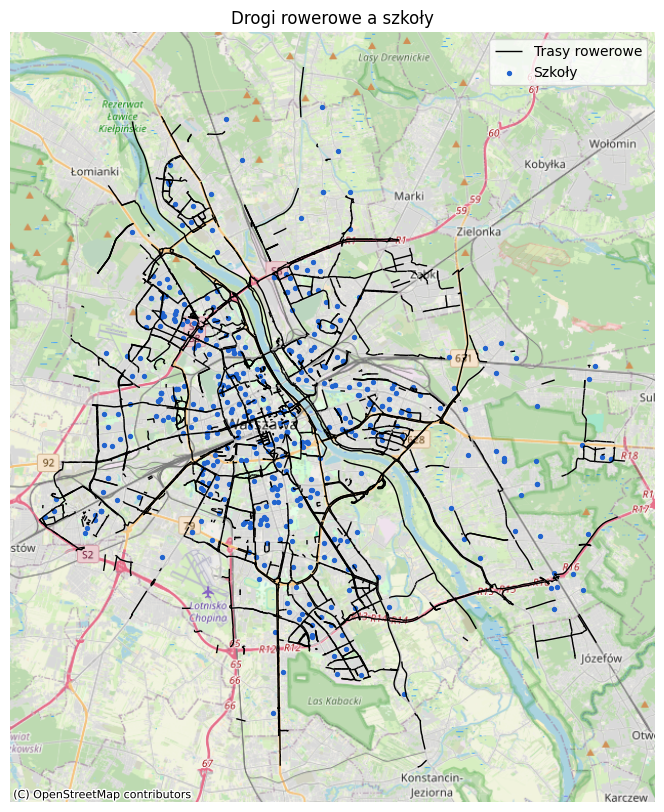

In [17]:
fig, ax = plt.subplots(figsize=(10, 10))
bike_paths.plot(ax=ax, color='black', linewidth=1, label='Trasy rowerowe')
schools_gdf.plot(ax=ax, color='#2164cf', markersize=8, label='Szkoły')
ctx.add_basemap(ax=ax, source=ctx.providers.OpenStreetMap.Mapnik)
plt.title('Drogi rowerowe a szkoły')
plt.axis('off')
plt.legend()
plt.show()

**Analiza:**
Na powyższej mapie możemy zauważyć, że w południowo-wschodniej części Warszawy jest znacznie mniej ścieżek rowerowych. W porównaniu do reszty miasta, w tym obszarze większość szkół nie znajduje się w pobliżu żadnej drogi rowerowej.

###### Parki i skwery a stacje Veturilo

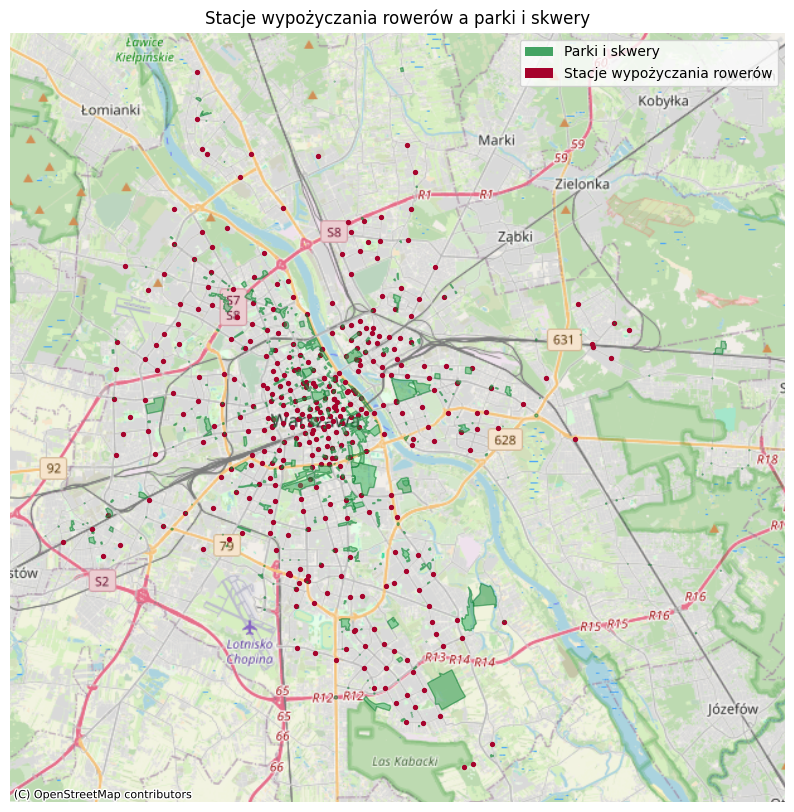

In [18]:
fig, ax = plt.subplots(figsize=(10, 10))
veturilo.plot(ax=ax, color='#a6032c', markersize=8)
enom_gdf.plot(ax=ax, facecolor='#43a363', edgecolor='#017829', alpha=0.5)
ctx.add_basemap(ax=ax, source=ctx.providers.OpenStreetMap.Mapnik)
plt.title('Stacje wypożyczania rowerów a parki i skwery')
plt.axis('off')
legend_elements = [
    Patch(facecolor='#43a363', label='Parki i skwery'),
    Patch(facecolor='#a6032c', label='Stacje wypożyczania rowerów')
]
plt.legend(handles=legend_elements, 
          loc='upper right')

plt.show()

**Analiza:**
Parki i skwery bywają częstym miejscem wycieczek rowerowych, szczególnie dla turystów. Na powyższej mapie możemy zauważyć, że w pobliżu większości terenów zielonych znajdują się stacje wypożyczania rowerów.

###### Punkty z defibrylatorami a drogi rowerowe

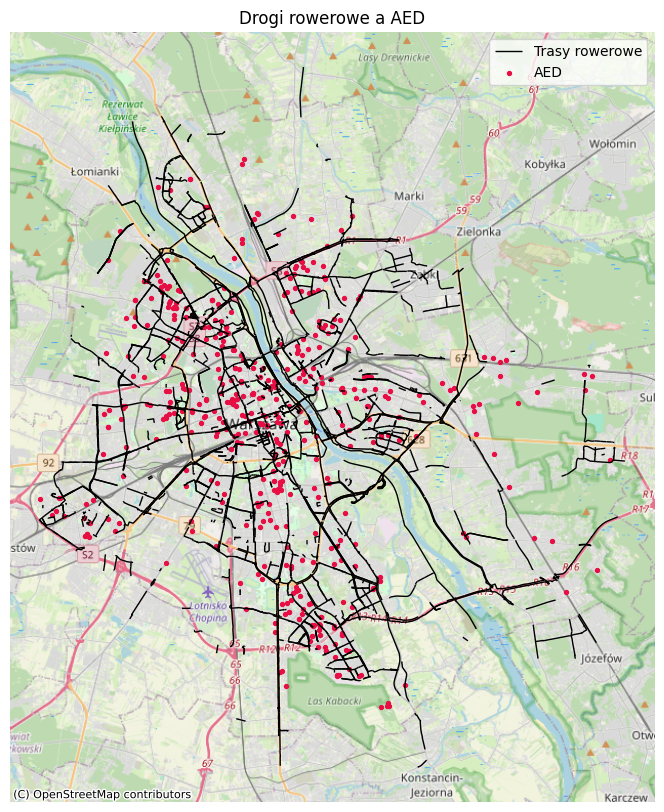

In [19]:
fig, ax = plt.subplots(figsize=(10, 10))
bike_paths.plot(ax=ax, color='black', linewidth=1, label='Trasy rowerowe')
aed_gdf.plot(ax=ax, color='#e80e44', markersize=8, label='AED')
ctx.add_basemap(ax=ax, source=ctx.providers.OpenStreetMap.Mapnik)
plt.title('Drogi rowerowe a AED')
plt.axis('off')
plt.legend()
plt.show()

**Analiza:**
Analizując powyższą mapę, możemy stwierdzić, że na znacznym obszarze miasta defibrylatory automatyczne znajdują się w pobliżu ścieżek rowerowych. Braki możemy dostrzec w pobliżu Wisły, na południe od centrum miasta.

###### Punkty Veturilo a dzielnice

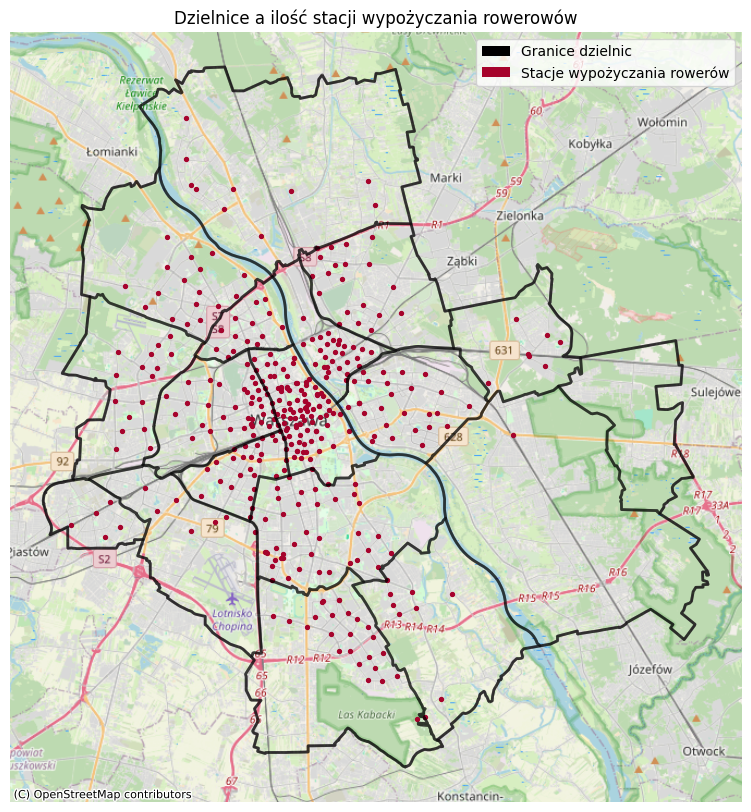

In [20]:
fig, ax = plt.subplots(figsize=(10, 10))

veturilo.plot(ax=ax, color='#a6032c', markersize=8)
districts_pop_gdf.plot(
    ax=ax,
    edgecolor='black',
    facecolor='none',
    linewidth=2,
    alpha=0.5,
    label='Locations',
)
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik) 
ax.axis('off')
ax.set_title("Dzielnice a ilość stacji wypożyczania rowerowów")
legend_elements = [
    Patch(facecolor='black', label='Granice dzielnic'),
    Patch(facecolor='#a6032c', label='Stacje wypożyczania rowerów')
]
plt.legend(handles=legend_elements, 
          loc='upper right')
plt.show()

**Analiza:**
Analizując powyższą mapę możemy zauważyć, że centrum miasta ma największą dostępność do stacji wypożyczania rowerów podczas gdy południowo-wschodnia część ma najmniejsze zagęszczenie stacji wypożyczania rowerów.

#### MAPA DYNAMICZNA

###### FUNKCJE POMOCNICZE I PRZETWARZANIE DANYCH

In [21]:
def districts_style_function(feature):
    return {
        'fillColor': '#399fe3',
        'color': '#345eeb',
        'weight': 1,
        'fillOpacity': 0.1
    }

def districts_highlight_function(feature):
    return {
        'fillOpacity': 0.3,
        'weight': 2
    }

def enom_style_function(feature):
    return {
        'fillColor': '#2ab54c',
        'color': '#01731e',
        'weight': 1,
        'fillOpacity': 0.1
    }

def enom_highlight_function(feature):
    return {
        'fillOpacity': 0.3,
        'weight': 2
    }


fm_bikepaths = bike_paths.copy()
fm_bikepaths = fm_bikepaths.to_crs(epsg=4326)
fm_bikepaths['MATE_NAWIE'] = fm_bikepaths['MATE_NAWIE'].fillna('inny')

fm_veturilo = veturilo.copy()
fm_veturilo = fm_veturilo.to_crs(epsg=4326)

fm_aed = aed_gdf.copy()
fm_aed = fm_aed.to_crs(epsg=4326)
fm_aed['device_access_description'] = fm_aed['device_access_description'].fillna('Brak danych')

fm_enom = enom_gdf.copy()
fm_enom = fm_enom.to_crs(epsg=4326)

fm_schools = schools_gdf.copy()
fm_schools = fm_schools.to_crs(epsg=4326)

fm_districts = districts_pop_gdf.copy()
fm_districts = fm_districts.to_crs(epsg=4326)

fm_bikesperpop = bikesperpop_gdf.copy()
fm_bikesperpop = fm_bikesperpop.to_crs(epsg=4326)
fm_bikesperpop['pop_per_bikes'] = np.ceil(fm_bikesperpop['pop_per_bikes'])
fm_bikesperpop['pop_per_bikes'] = fm_bikesperpop['pop_per_bikes'].replace([np.inf, -np.inf], '-')

###### GENEROWANIE MAPY DYNAMICZNEJ

In [22]:

fm = folium.Map(location=[52.2297, 21.0122], zoom_start=10)

# Districts layer
folium.GeoJson(
    fm_bikesperpop,
    name='Dzielnice',
    style_function=districts_style_function,
    highlight_function=districts_highlight_function,
    popup=folium.GeoJsonPopup(
        fields=['district', 'population', 'bikes', 'pop_per_bikes'],
        aliases=['Dzielnica:', 'Liczba mieszkańców:','Liczba rowerów:', 'Liczba mieszkańców na jeden rower:'],
        localize=True
    )
).add_to(fm)

# Veturilo heatmap
heat_group = folium.FeatureGroup(
    name='Mapa ciepła ilości rowerów',
    show=False)
heat_data = [
    [row.geometry.y, row.geometry.x, row["Ilość st"]]
    for _, row in fm_veturilo.iterrows()
    if row["Ilość st"] > 0
]
HeatMap(
    heat_data,
    radius=15,
    blur=15,
    min_opacity=0.5
    ).add_to(heat_group)
heat_group.add_to(fm)

# Veturilo markers
with open('data\\icons\\bike.svg', 'r') as f:
    bike_icon = f.read()
veturilo_marker_cluster = MarkerCluster(
    name='Stacje Veturilo',
    show=False)
for idx, row in fm_veturilo.iterrows():
    folium.Marker(
        location=[row.geometry.y, row.geometry.x],
        popup=folium.Popup(
            f"Lokalizacja: {row['Lokalizacj']}<br>"
            f"Liczba stojaków: {row['Ilość st']}"
        ),
         icon=folium.DivIcon(
            html=bike_icon,
            icon_size=(35, 35),
            icon_anchor=(15, 15),
            popup_anchor=(0, -15),
            class_name='bike-icon'
        )
    ).add_to(veturilo_marker_cluster)
veturilo_marker_cluster.add_to(fm)

# Bike paths
unique_surface = fm_bikepaths['MATE_NAWIE'].unique()
surface_colors = {
    'kostka prefabrykowana': '#038c9e',
    'masa bitumiczna': '#c23484',
    'grunt naturalny': '#256914',
    'kostka kamienna': '#293fcf',
    'płyty betonowe': '#94701b',
    'beton': '#595902',
    'bruk': '#5e011a',
    'inny': '#6b6a6a',
}
all_surfaces_layer = folium.FeatureGroup(name="Wszystkie trasy rowerowe", show=False)
surface_layers = {} 
for surface_type in unique_surface:
    surface_layer = folium.FeatureGroup(name=f"Nawierzchnia: {surface_type}", show=False)
    for _, row in fm_bikepaths.iterrows():
        if row.geometry.geom_type == 'LineString' and row["MATE_NAWIE"] == surface_type:
            folium.PolyLine(
                locations=[(point[1], point[0]) for point in row.geometry.coords],
                color=surface_colors.get(surface_type, 'gray'),
                weight=3, opacity=1
            ).add_to(surface_layer)

            folium.PolyLine(
                locations=[(point[1], point[0]) for point in row.geometry.coords],
                color='black',
                weight=2, opacity=1
            ).add_to(all_surfaces_layer)
    
    surface_layers[surface_type] = surface_layer
    surface_layer.add_to(fm)
all_surfaces_layer.add_to(fm)

# Schools markers
with open('data\\icons\\school.svg', 'r') as f:
    school_icon = f.read()
school_marker_cluster = MarkerCluster(
    name='Szkoły',
    show=False)
for idx, row in fm_schools.iterrows():
    folium.Marker(
        location=[row.geometry.y, row.geometry.x],
        popup=folium.Popup(
            f"{row['Nazwa szkoły/ jednostki']}"
        ),
         icon=folium.DivIcon(
            html=school_icon,
            icon_size=(35, 35),
            icon_anchor=(15, 15),
            popup_anchor=(0, -15),
            class_name='school-icon'
        )
    ).add_to(school_marker_cluster)
school_marker_cluster.add_to(fm)

# AEDs markers
with open('data\\icons\\aed.svg', 'r') as f:
    aed_icon = f.read()
aed_marker_cluster = MarkerCluster(
    name='Defibrylatory',
    show=False)
for idx, row in fm_aed.iterrows():
    folium.Marker(
        location=[row.geometry.y, row.geometry.x],
        popup=folium.Popup(
            f"Ulica: {row['location_street']}<br>"
            f"Dostępność: {row['device_location']}, {row['device_public_access']}<br>"
            f"Godziny dostępności: {row['device_access_description']}<br>"
        ),
        icon=folium.DivIcon(
            html=aed_icon,
            icon_size=(35, 35),
            icon_anchor=(15, 15),
            popup_anchor=(0, -15),
            class_name='aed_icon'
        )
    ).add_to(aed_marker_cluster)
aed_marker_cluster.add_to(fm)

# squares layer
folium.GeoJson(
    fm_enom,
    name='Place i skwery',
    show=False,
    style_function=enom_style_function,
    highlight_function=enom_highlight_function,
    popup=folium.GeoJsonPopup(
        fields=['NAZWA_PODST', 'DZIELNICE'],
        aliases=['Nazwa:', 'Dzielnica:'],
        localize=True
    )
).add_to(fm)

# SHOW MAP
folium.LayerControl().add_to(fm)
fm.save('data\\dynamic_map.html')
fm

**Obserwacje, analiza, wniski:**
Mapa dynamiczana pozwala nam odczytać dokładne dane odnośnie liczby mieszkańców przypadających na jeden rower z podziałem na dzielnice. Analizując dzielnice takie jak Wesoła oraz Wawer możemy stwierdzić znaczne braki w dostępności do stacji wypożyczania rowerów. Gdy w innych dzielnicach na jeden rower przypada maksymalnie kilkaset mieszkańców, w dzielnicy Wawer na jeden rower przypada prawie 8 tysięcy mieszkańców, a w dzielnicy Wesoła nie ma żadnej stacji wypożyczania rowerów. Z tego wynika, że kolejne inwestycje w stacje wypożyczania rowerów powinny przypadać właśnie na te dwie dzielnice. Ponadto, możemy zaobserwować braki w ilości ścieżek rowerowych w dwóch wyżej wspomnianych dzielnicach, co również sugeruje lokalizacje dalszych inwestycji w ścieżki rowerowe.

#### TIMELAPSE

###### FUNCKJE POMOCNICZE I PRZETWARZANIE DANYCH

In [23]:
def extract_year(label_dict):
    if not label_dict or '_label_' not in label_dict:
        return None
        
    text = label_dict['_label_']
    year_match = re.search(r'Rok budowy/remontu: (.*?)(?:\n|$)', text)
    
    if not year_match:
        return None
        
    year_value = year_match.group(1)

    if year_value == 'brak danych':
        return None

    if year_value.isdigit():
        return int(year_value)
        
    return None

def process_message_json(json_file):
    with open(json_file, 'r', encoding='utf-8') as f:
        data = json.load(f)
    
    i = 0
    lines = []
    ids = []
    years = []
    for item in data:
        _id = item['_id']
        geometry = item['geometry']
        properties = item['properties']
        year = extract_year(properties)
        if not year:
            continue
        if geometry['type'] != 'LineString':
            continue

        coords1 = []
        coords2 = []
        for index, coord in enumerate(geometry['coordinates']):
            if index % 2 == 0:
                coords1.append(coord)
            else:
                coords2.append(coord)
        
        coords = list(zip(coords1, coords2))
        lines.append(LineString(coords))
        ids.append(_id)
        years.append(year)

    gdf = gpd.GeoDataFrame({'id': ids, 'year': years}, geometry=lines, crs='EPSG:2178')
    return gdf

In [24]:
timelapse_gdf = process_message_json('data/broutes_date.json')
timelapse_gdf = timelapse_gdf.to_crs(epsg=4326)
display(timelapse_gdf.head())


,id,year,geometry
0,ABeSwIAABAAP8o+AAA,2021,"LINESTRING (21.03491 52.37838, 21.03519 52.379..."
1,ABeSwIAABAAP8hXAAA,2021,"LINESTRING (21.03866 52.42048, 21.03863 52.420..."
2,ABeSwIAABAAP8VkAAA,2020,"LINESTRING (21.09871 52.33907, 21.0987 52.3390..."
3,ABeSwIAABAAP8R9AAB,2021,"LINESTRING (21.15644 52.33307, 21.15646 52.333..."
4,ABeSwIAABAAP8VBAAB,2022,"LINESTRING (21.0559 52.34089, 21.05586 52.3408..."


###### FORMAT .GIF

In [25]:
gif_timelapse = timelapse_gdf.copy()
gif_timelapse = gif_timelapse.to_crs(epsg=3857)

In [26]:
WARSAW_CENTER = (2338552.675489827, 6841916.603611625)
MARGIN = 30000

def animate(frame_year):
    ax.clear()
    mask = gif_timelapse['year'] <= frame_year
    gif_timelapse[mask].plot(
        ax=ax,
        color='blue',
        linewidth=1.5,
        alpha=0.7
    )

    ax.axis('on')
    ax.set_xlim([WARSAW_CENTER[0] - MARGIN, WARSAW_CENTER[0] + MARGIN])
    ax.set_ylim([WARSAW_CENTER[1] - MARGIN, WARSAW_CENTER[1] + MARGIN])
    
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
    
    ax.set_title(f'Rozwój tras rowerowych w Warszawie na przestrzeni lat\nRok: {frame_year}', fontsize=20)
    ax.axis('off')

In [27]:
fig, ax = plt.subplots(figsize=(10, 10))
years = sorted(gif_timelapse['year'].unique())

anim = FuncAnimation(
    fig, 
    animate,
    frames=years,
    interval=500,
    repeat=True
)

anim.save('data\\bike_routes_timelapse.gif', writer='pillow')
plt.close()

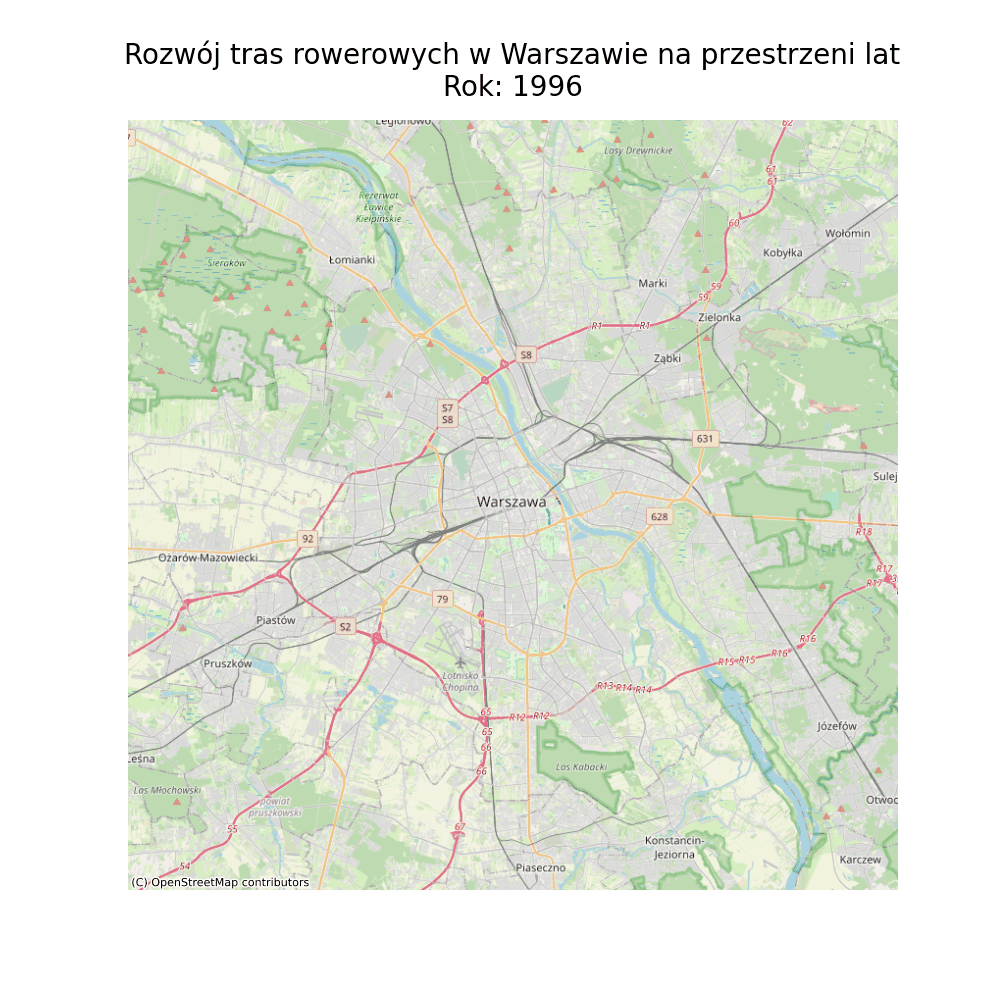

In [28]:
display(Image(filename='data\\bike_routes_timelapse.gif'))

###### TIMELAPSE FOLIUM

In [30]:
m = folium.Map(location=[52.2297, 21.0122], zoom_start=11)

features = []
end_time = "2026-01-01T00:00:00"
for _, row in timelapse_gdf.iterrows():
    start_time = f"{row['year']}-01-01T00:00:00"
    if row['year'] < 2002:
        start_time = "2002-01-01T00:00:00"
    feature = {
        'type': 'Feature',
        'geometry': {
            'type': 'LineString',
            'coordinates': [[p[0], p[1]] for p in row.geometry.coords]
        },
        'properties': {
            'times': ['2002-01-01T00:00:00', start_time],
            'style': {
                'color': '#7418c4',
                'weight': 2,
            }
        }
    }
    features.append(feature)
folium.plugins.TimestampedGeoJson(
    {
        "type": "FeatureCollection",
        "features": features,
    },
    period="P1Y",
    add_last_point=False,
    transition_time=500,
).add_to(m)
fm.save('data\\timelapse_dynamic_map.html')
m

**Obserwacje, analiza, wnioski:**
Z powyższych animacji wynika, że w latach 2000-2010 miasto nie skupiało się na rozwoju infrastruktury rowerowej. Dopiero od roku 2011 możemy zaobserwować większy przyrost liczby ścieżek rowerowych, natomiast dopiero od 2020 roku możemy zauważyć największe przyrosty.
